## 관련 패키지 불러오기

In [1]:
import pandas as pd

In [2]:
import geopandas as gpd

In [3]:
#import fiona #공간데이터를 딕셔너리 형태 등으로 접근할 수 있는 라이브러리 
from fiona.crs import from_epsg # 좌표변환 

In [4]:
#import pyproj  # 좌표변환
from pyproj import Proj, transform

# import shapely
# from shapely.geometry.multipolygon import MultiPolygon 
# from shapely.geometry import LineString, Point
# from shapely import wkt

In [5]:
import matplotlib
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
sns.set_style('darkgrid') #whitegrid, dark, white, ticks
mpl.rc('font', family='NanumGothic') #한글 폰트 적용시
plt.rcParams["figure.figsize"] = (15,10) #차트 사이즈

In [6]:
import folium
import mapclassify as mc
import contextily as ctx  #conda install contextily 또는 pip install contextily
#import cartopy

## 데이터

### 행정구역 공간데이터

In [7]:
#깃허브의 해당 파일 download 버튼 URL 확인 
geojson_sido2 = 'https://github.com/vuski/admdongkor/raw/8e737c267b9006e1e71ca09853c2355d0b452906/ver20201001/HangJeongDong_ver20201001.geojson'

In [8]:
geojson_sido2

'https://github.com/vuski/admdongkor/raw/8e737c267b9006e1e71ca09853c2355d0b452906/ver20201001/HangJeongDong_ver20201001.geojson'

In [9]:
# geojson을 geopandas의 geoDataFrame으로 변환
gdf_sido2 = gpd.read_file(geojson_sido2)
#gdf_sido2 = gpd.read_file('https://github.com/vuski/admdongkor/raw/8e737c267b9006e1e71ca09853c2355d0b452906/ver20201001/HangJeongDong_ver20201001.geojson')

print(gdf_sido2.crs, '\n')
gdf_sido2.info()
gdf_sido2.head()

epsg:4326 

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 3492 entries, 0 to 3491
Data columns (total 9 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   OBJECTID  3492 non-null   int64   
 1   adm_nm    3492 non-null   object  
 2   adm_cd    3492 non-null   object  
 3   adm_cd2   3492 non-null   object  
 4   sgg       3492 non-null   object  
 5   sido      3492 non-null   object  
 6   sidonm    3492 non-null   object  
 7   sggnm     3492 non-null   object  
 8   geometry  3492 non-null   geometry
dtypes: geometry(1), int64(1), object(7)
memory usage: 245.7+ KB


,OBJECTID,adm_nm,adm_cd,adm_cd2,sgg,sido,sidonm,sggnm,geometry
0,1,서울특별시 종로구 사직동,1101053,1111053000,11110,11,서울특별시,종로구,"MULTIPOLYGON (((126.97689 37.57565, 126.97703 ..."
1,2,서울특별시 종로구 삼청동,1101054,1111054000,11110,11,서울특별시,종로구,"MULTIPOLYGON (((126.98269 37.59507, 126.98337 ..."
2,3,서울특별시 종로구 부암동,1101055,1111055000,11110,11,서울특별시,종로구,"MULTIPOLYGON (((126.97585 37.59656, 126.97359 ..."
3,4,서울특별시 종로구 평창동,1101056,1111056000,11110,11,서울특별시,종로구,"MULTIPOLYGON (((126.97507 37.63139, 126.97649 ..."
4,5,서울특별시 종로구 무악동,1101057,1111057000,11110,11,서울특별시,종로구,"MULTIPOLYGON (((126.96067 37.58080, 126.96281 ..."


In [10]:
# 행정구역에서 서울만 추출
gdf_sido3 = gdf_sido2[ gdf_sido2['sido'] == '11' ]
gdf_sido3.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<AxesSubplot:>

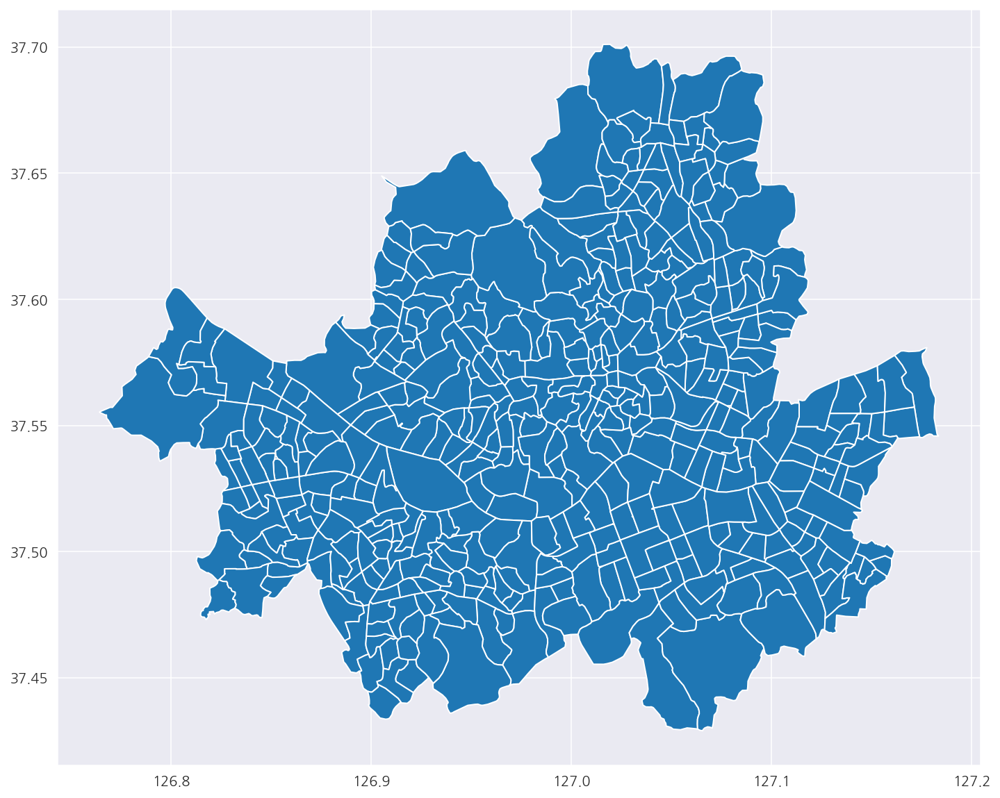

In [11]:
gdf_sido3.plot()

In [12]:
# 좌표계 변환
gdf_sido3_3857 = gdf_sido3.to_crs(epsg=3857) 

### CCTV 포인트 공간데이터

In [13]:
# shp 로딩
gdf_cctv_sl03 = gpd.read_file('./data/gdf_cctv_sl03.shp', encoding='utf-8')  #euc-kr, euckr, utf-8, cp949 중 선택
gdf_cctv_sl03.crs  #좌표계 확인용 

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [14]:
# Dataframe you want to plot
gdf_cctv_sl03_3857 = gdf_cctv_sl03.to_crs(epsg=3857) # reproject it in Web mercator
# Geometry를 이용하여 X, Y 좌표 항목을 생성 
gdf_cctv_sl03_3857["x"] = gdf_cctv_sl03_3857.geometry.x
gdf_cctv_sl03_3857["y"] = gdf_cctv_sl03_3857.geometry.y
gdf_cctv_sl03_3857.head(3)

,admin_nm,addr_rd,addr_jb,purpose,cctv_cnt,pixel,direction,period,date_insta,tel,...,date_make,offer_admi,offer_ad_1,sl,zscore_lon,outliers,zscore_lat,geometry,x,y
0,서울특별시 영등포구,"선유로13길 25,서울영문초등학교 사거리앞",선유로13길 25,생활방범,3,None,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.348028,0,-0.950876,POINT (14124991.821 4511747.327),1.412499e+07,4.511747e+06
1,서울특별시 영등포구,"문래로4길 4,현대2차APT 202동 옆 서부간선도로 사잇길 육교앞",문래로4길 4,생활방범,2,None,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.406838,0,-0.937394,POINT (14124451.882 4511863.040),1.412445e+07,4.511863e+06
2,서울특별시 영등포구,"선유로9나길 22,사거리앞",문래동5가 12 사거리앞,생활방범,3,None,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.358297,0,-1.007738,POINT (14124897.547 4511259.295),1.412490e+07,4.511259e+06


<ipython-input-15-8cf26729eb42>:4: FutureWarning: The "contextily.tile_providers" module is deprecated and will be removed in contextily v1.1. Please use "contextily.providers" instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TERRAIN)
<ipython-input-15-8cf26729eb42>:4: FutureWarning: The "url" option is deprecated. Please use the "source" argument instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TERRAIN)


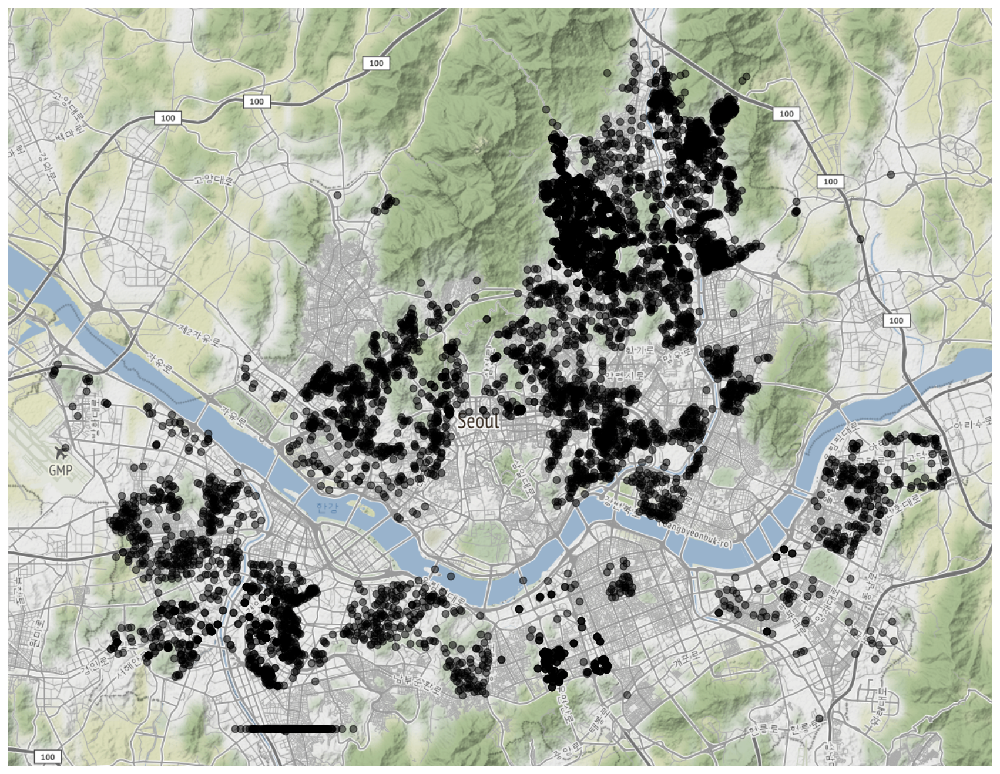

In [15]:
ax = gdf_cctv_sl03_3857.plot(figsize=(15, 15), color='black', alpha=0.5)

# choose any of the supported maps from ctx.sources
ctx.add_basemap(ax, url=ctx.sources.ST_TERRAIN)
ax.set_axis_off()
plt.show()

### 배경맵
http://maps.stamen.com/#toner/13/37.5500/126.9996

https://contextily.readthedocs.io/en/latest/providers_deepdive.html

## Seaborn

<ipython-input-17-8b7342fb64e1>:3: FutureWarning: The "contextily.tile_providers" module is deprecated and will be removed in contextily v1.1. Please use "contextily.providers" instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TERRAIN)
<ipython-input-17-8b7342fb64e1>:3: FutureWarning: The "url" option is deprecated. Please use the "source" argument instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TERRAIN)


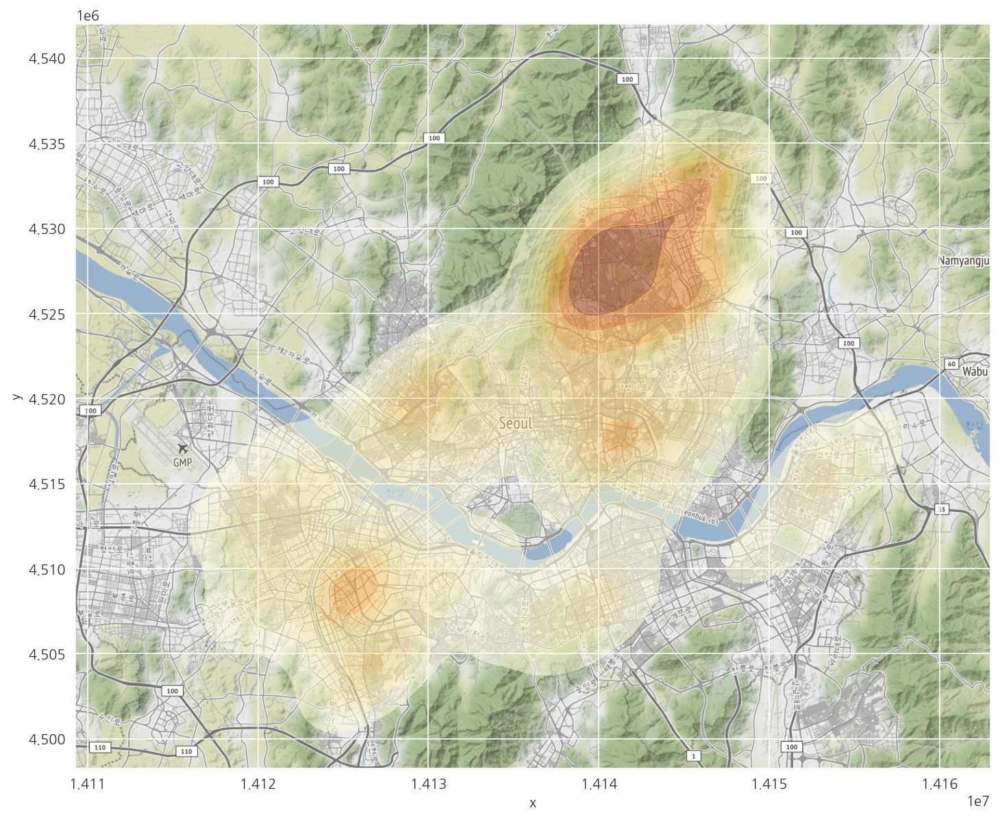

In [17]:
#Seaborn을 이용한 지리적 히트맵 
ax = sns.kdeplot(data=gdf_cctv_sl03_3857, x=gdf_cctv_sl03_3857["x"], y=gdf_cctv_sl03_3857["y"], fill=True, cmap="YlOrBr", alpha=0.5)
ctx.add_basemap(ax, url=ctx.sources.ST_TERRAIN)
#https://seaborn.pydata.org/tutorial/color_palettes.html?highlight=colormap

https://seaborn.pydata.org/generated/seaborn.kdeplot.html

### Geoplot을 이용해서도 Heatmap을 표현할 수 있습니다.
https://residentmario.github.io/geoplot/gallery/plot_nyc_collision_factors.html  
https://residentmario.github.io/geoplot/gallery/plot_boston_airbnb_kde.html  

## Animation Heatmap
연도별로 CCTV가 주로 설치된 지역을 시각화해보자 

#### 연도 전처리

In [18]:
gdf_cctv_sl03['date_insta'] = gdf_cctv_sl03['date_insta'].str.replace(pat='Mar-16', repl= '2016-03', regex=True)
gdf_cctv_sl03['date_insta'] = gdf_cctv_sl03['date_insta'].str.replace(pat='Aug-16', repl= '2016-08', regex=True)
gdf_cctv_sl03['date_insta'] = gdf_cctv_sl03['date_insta'].str.replace(pat='May-16', repl= '2016-05', regex=True)
gdf_cctv_sl03['date_insta'] = gdf_cctv_sl03['date_insta'].str.replace(pat='Jun-16', repl= '2016-06', regex=True)
gdf_cctv_sl03['date_insta'] = gdf_cctv_sl03['date_insta'].str.replace(pat='Oct-16', repl= '2016-10', regex=True)

In [19]:
# 설치년도가 없는 데이터 삭제
gdf_cctv_sl03.dropna(subset=['date_insta'],axis=0,inplace=True)

In [20]:
gdf_cctv_sl03['year'] = gdf_cctv_sl03['date_insta'].str[:4] #앞 4자리 문자열만 추출

In [21]:
# 연도 항목을 정수형으로 변환
gdf_cctv_sl03['year2'] = gdf_cctv_sl03['year'].astype(int)

In [22]:
# Dataframe you want to plot
gdf_cctv_sl03_3857 = gdf_cctv_sl03.to_crs(epsg=3857) # reproject it in Web mercator
# Geometry를 이용하여 X, Y 좌표 항목을 생성 
gdf_cctv_sl03_3857["x"] = gdf_cctv_sl03_3857.geometry.x
gdf_cctv_sl03_3857["y"] = gdf_cctv_sl03_3857.geometry.y
#gdf_cctv_sl03_3857.head()

## 연도별 kdeplot 이미지 저장   
image 폴더 아래에 heatmap이라는 폴더를 미리 만들어 주세요~  

### Seaborn의 kdeplot 응용  
https://seaborn.pydata.org/generated/seaborn.kdeplot.html  

<ipython-input-24-e8bffa30a08e>:2: FutureWarning: The "contextily.tile_providers" module is deprecated and will be removed in contextily v1.1. Please use "contextily.providers" instead.
  lvl = ctx.Place('Seoul', url=ctx.sources.ST_TONER_LITE)
<ipython-input-24-e8bffa30a08e>:2: FutureWarning: The "url" option is deprecated. Please use the "source" argument instead.
  lvl = ctx.Place('Seoul', url=ctx.sources.ST_TONER_LITE)


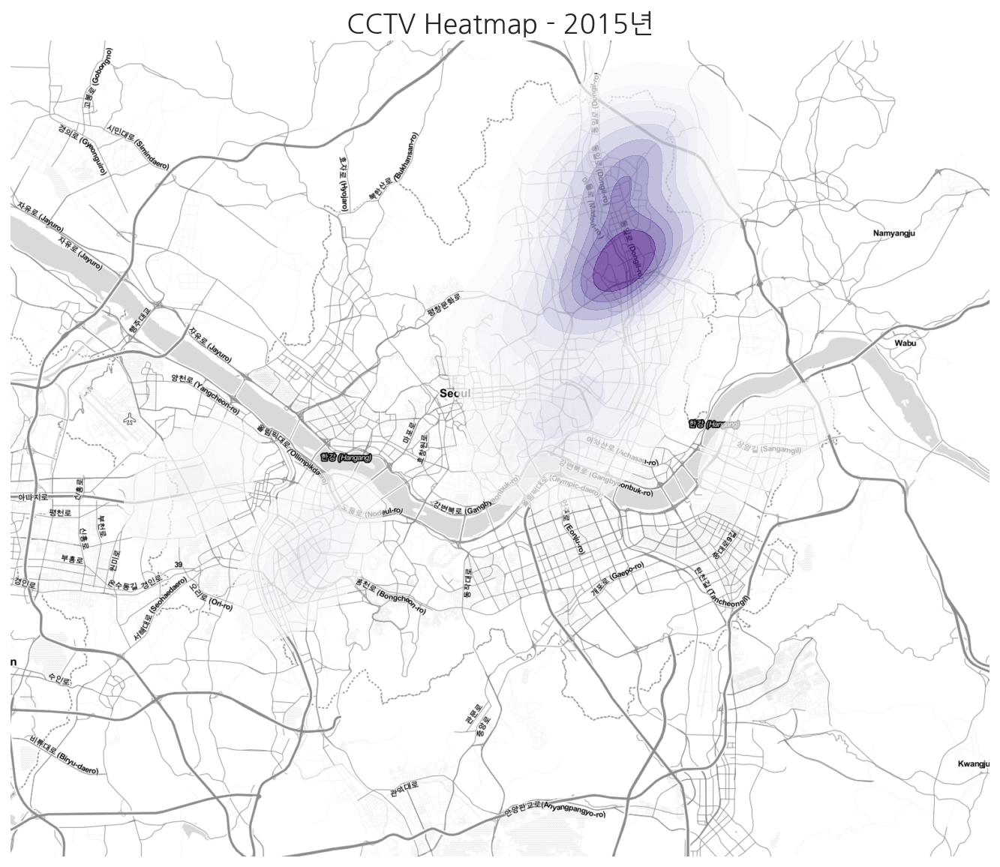

In [24]:
# 2015년 
lvl = ctx.Place('Seoul', url=ctx.sources.ST_TONER_LITE)
ax = sns.kdeplot(data=gdf_cctv_sl03_3857[gdf_cctv_sl03_3857['year2'] == 2015], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2015년', fontsize=18)
#fig = plt.gcf()
plt.savefig("./image/heatmap/heatmap_2015.png", bbox_inches='tight', pad_inches=0.01)
plt.show()

<ipython-input-97-e3df82a360bc>:5: FutureWarning: The "contextily.tile_providers" module is deprecated and will be removed in contextily v1.1. Please use "contextily.providers" instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TONER_LITE)
<ipython-input-97-e3df82a360bc>:5: FutureWarning: The "url" option is deprecated. Please use the "source" argument instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TONER_LITE)


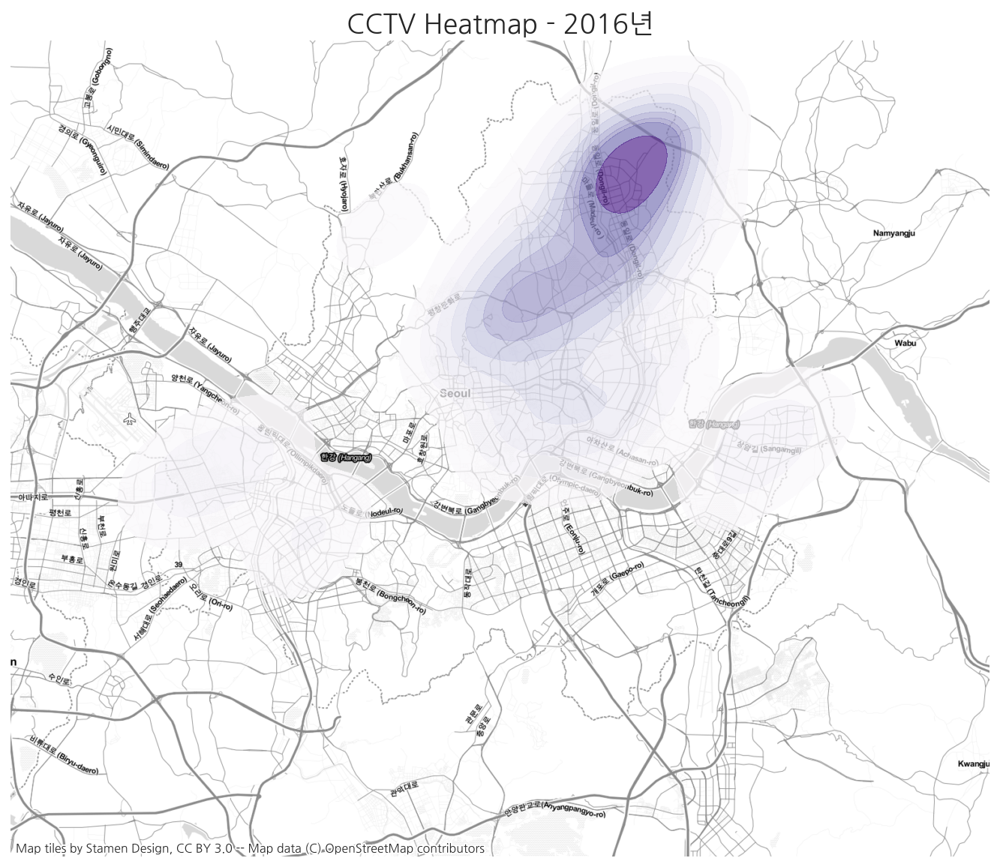

In [97]:
# 2016년 
lvl = ctx.Place('Seoul', url=ctx.sources.ST_TONER_LITE)
ax = sns.kdeplot(data=gdf_cctv_sl03_3857[gdf_cctv_sl03_3857['year2'] == 2016], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2016년', fontsize=18)
plt.savefig("./image/heatmap/heatmap_2016.png", bbox_inches='tight', pad_inches=0.01)

<ipython-input-98-cf5efad83d25>:5: FutureWarning: The "contextily.tile_providers" module is deprecated and will be removed in contextily v1.1. Please use "contextily.providers" instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TONER_LITE)
<ipython-input-98-cf5efad83d25>:5: FutureWarning: The "url" option is deprecated. Please use the "source" argument instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TONER_LITE)


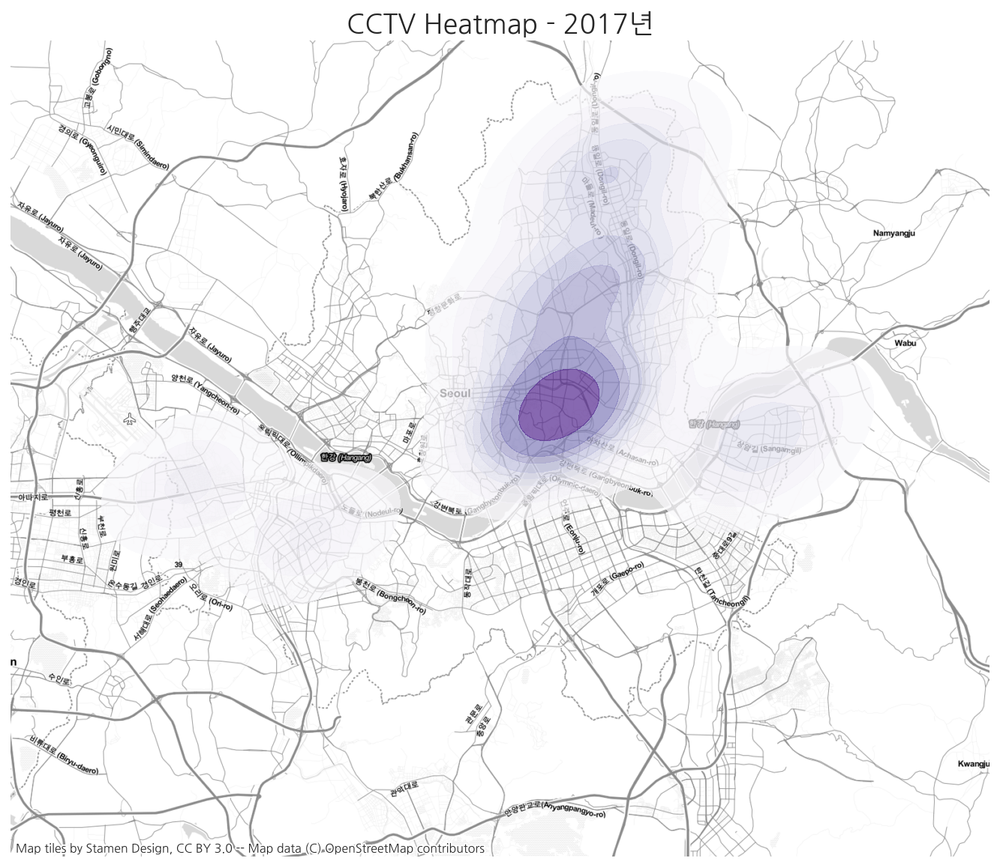

In [98]:
# 2017년 
lvl = ctx.Place('Seoul', url=ctx.sources.ST_TONER_LITE)
ax = sns.kdeplot(data=gdf_cctv_sl03_3857[gdf_cctv_sl03_3857['year2'] == 2017], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2017년', fontsize=18)
plt.savefig("./image/heatmap/heatmap_2017.png", bbox_inches='tight', pad_inches=0.01)

<ipython-input-99-c21d62d2dacb>:5: FutureWarning: The "contextily.tile_providers" module is deprecated and will be removed in contextily v1.1. Please use "contextily.providers" instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TONER_LITE)
<ipython-input-99-c21d62d2dacb>:5: FutureWarning: The "url" option is deprecated. Please use the "source" argument instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TONER_LITE)


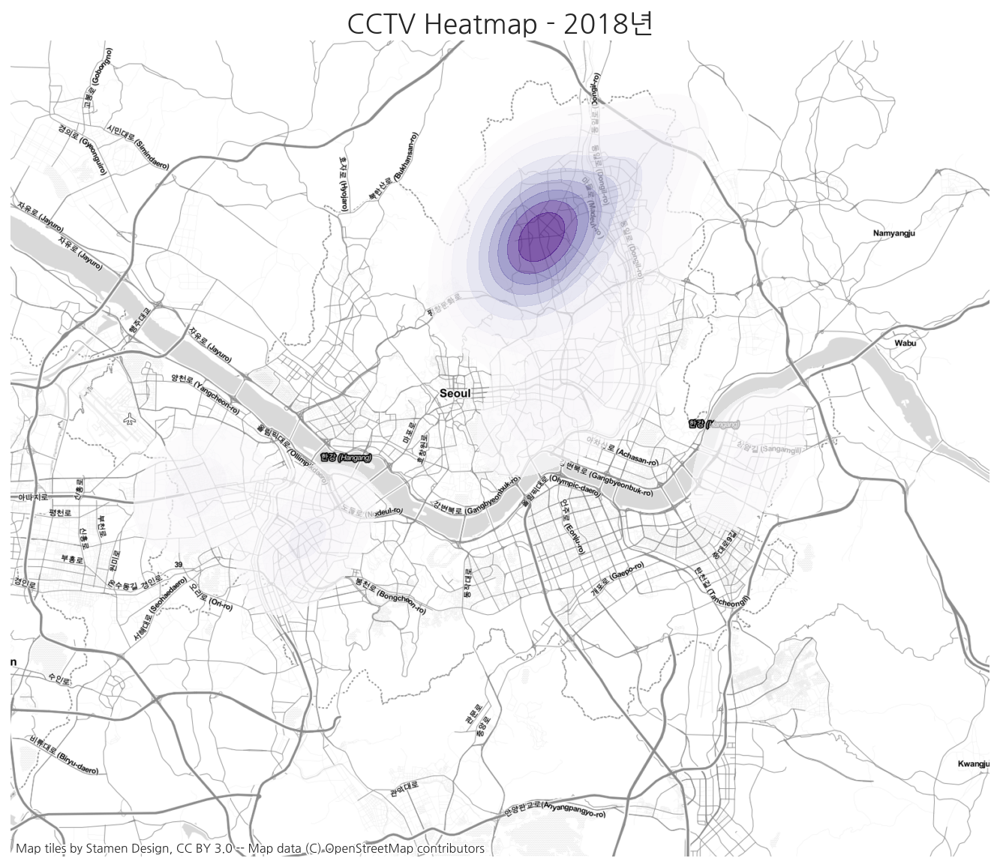

In [99]:
# 2018년 
lvl = ctx.Place('Seoul', url=ctx.sources.ST_TONER_LITE)
ax = sns.kdeplot(data=gdf_cctv_sl03_3857[gdf_cctv_sl03_3857['year2'] == 2018], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2018년', fontsize=18)
plt.savefig("./image/heatmap/heatmap_2018.png", bbox_inches='tight', pad_inches=0.01)

<ipython-input-100-ceab5bd2f91e>:5: FutureWarning: The "contextily.tile_providers" module is deprecated and will be removed in contextily v1.1. Please use "contextily.providers" instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TONER_LITE)
<ipython-input-100-ceab5bd2f91e>:5: FutureWarning: The "url" option is deprecated. Please use the "source" argument instead.
  ctx.add_basemap(ax, url=ctx.sources.ST_TONER_LITE)


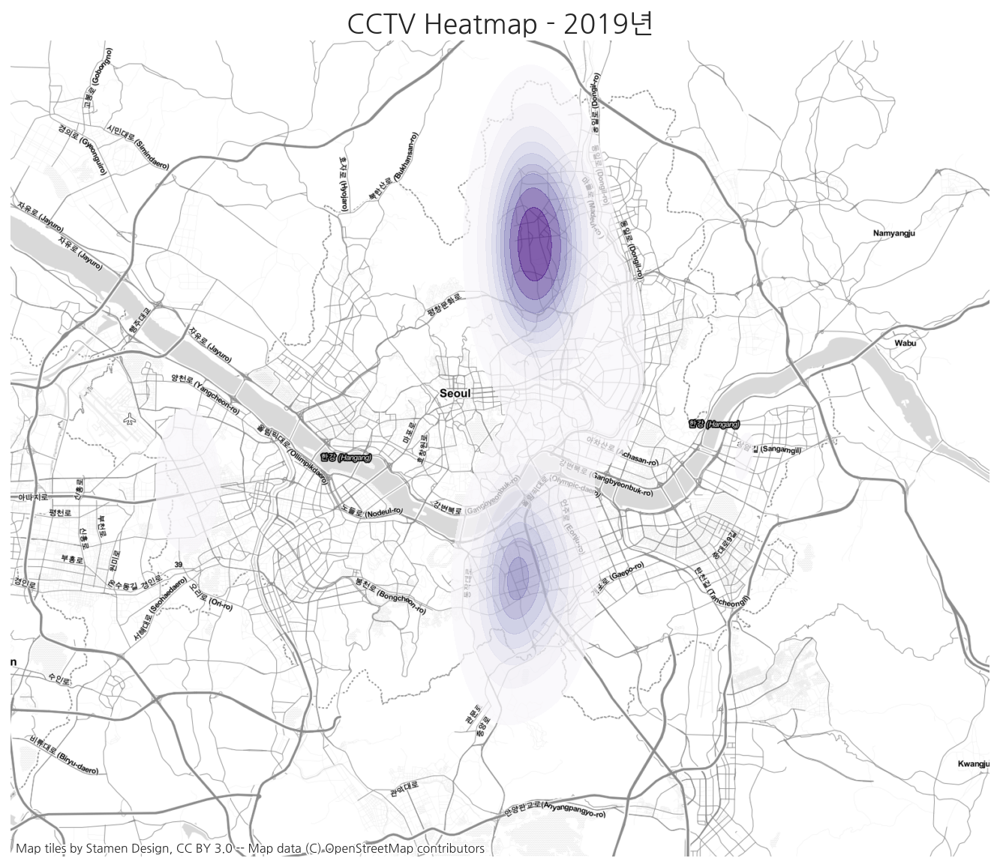

In [100]:
# 2019년 
lvl = ctx.Place('Seoul', url=ctx.sources.ST_TONER_LITE)
ax = sns.kdeplot(data=gdf_cctv_sl03_3857[gdf_cctv_sl03_3857['year2'] == 2019], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2019년', fontsize=18)
plt.savefig("./image/heatmap/heatmap_2019.png", bbox_inches='tight', pad_inches=0.01)

<ipython-input-104-c1e4e7c64325>:2: FutureWarning: The "contextily.tile_providers" module is deprecated and will be removed in contextily v1.1. Please use "contextily.providers" instead.
  lvl = ctx.Place('Seoul', url=ctx.sources.ST_TONER_LITE)
<ipython-input-104-c1e4e7c64325>:2: FutureWarning: The "url" option is deprecated. Please use the "source" argument instead.
  lvl = ctx.Place('Seoul', url=ctx.sources.ST_TONER_LITE)


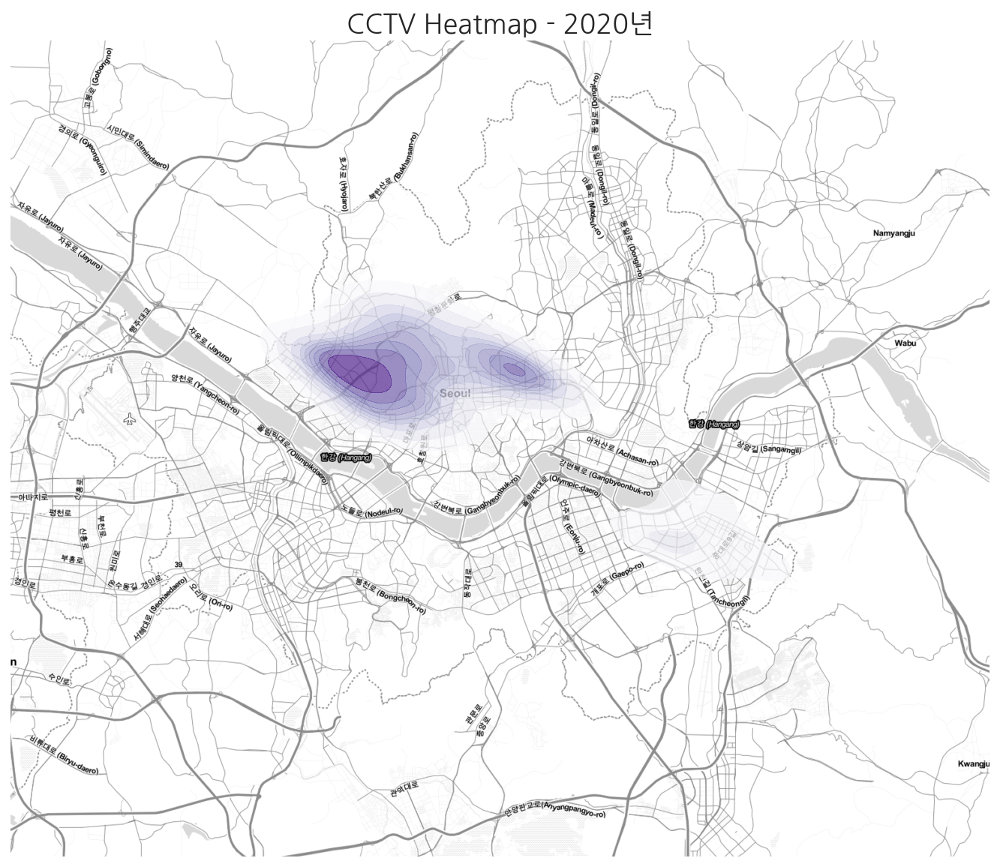

In [104]:
# 2020년 
lvl = ctx.Place('Seoul', url=ctx.sources.ST_TONER_LITE)
ax = sns.kdeplot(data=gdf_cctv_sl03_3857[gdf_cctv_sl03_3857['year2'] == 2020], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2020년', fontsize=18)
plt.savefig("./image/heatmap/heatmap_2020.png", bbox_inches='tight', pad_inches=0.01)

#### 만들어진 연도별 이미지 파일들을 GIF로 생성

In [25]:
from pathlib import Path
import imageio    #!pip install imageio

In [26]:
image_path = Path('./image/heatmap') #특정 폴더/경로 지정
images = list(image_path.glob('*.png'))  #해당 경로의 특정 포맷에 대한 (이미지) 파일명 리스트 생성
image_list = []   
for file_name in images:  #Animated GIF 생성용 리스트에 추가
    image_list.append(imageio.imread(file_name))

In [103]:
# Animated GIF 생성 
imageio.mimwrite('./image/heatmap/cctv_heatmap.gif', image_list, fps=0.5, loop=True ) #fps는 초 단위

#### 지명을 이용하여 배경지도 위치를 고정

<AxesSubplot:xlabel='X', ylabel='Y'>

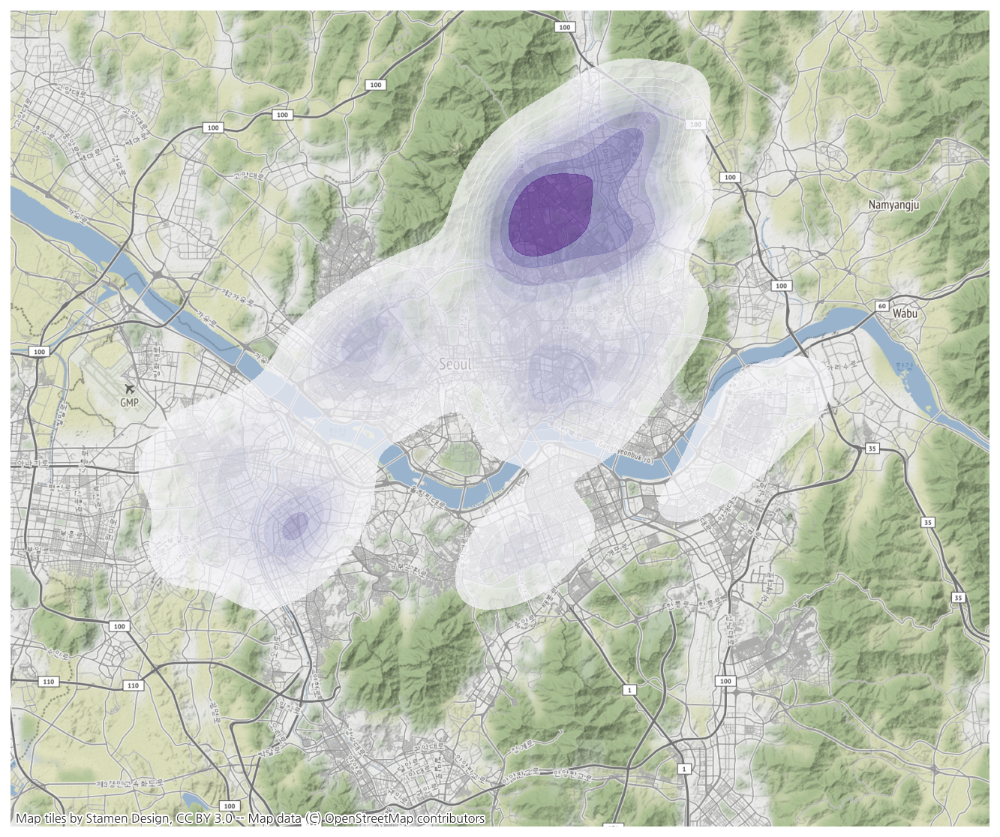

In [105]:
lvl = ctx.Place('Seoul') #, url=ctx.sources.ST_TONER_LITE)
ax = sns.kdeplot(data=gdf_cctv_sl03_3857, x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
ax.set_axis_off()
lvl.plot(ax)

"16_spatial_aggregate" 에서는 Folium을 이용한 히트맵도 만들어 볼 예정입니다.
시간이 여유 있는 분들은 미리 예습하셔도 좋습니다~~^^